In [26]:
#import libs
import numpy as np
import pandas as pd
from PIL import Image
import cv2
import matplotlib.pyplot as plt
import re
from keras.preprocessing.text import Tokenizer
from keras.applications.vgg16 import preprocess_input
from tensorflow.keras.optimizers import RMSprop
from keras.preprocessing.sequence import pad_sequences
import pickle
from PIL import Image
from tensorflow.keras.applications.inception_v3 import preprocess_input
%matplotlib inline


## Importing and all

In [27]:
data = pd.read_csv('../results.csv', error_bad_lines=False)

C:\Users\sarth\Anaconda3\envs\gputest\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (7,8,9) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [28]:
print(data.columns)

Index(['image_name| comment_number| comment', ' one ', 'two', 'Unnamed: 3',
       'Unnamed: 4', 'Unnamed: 5', 'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8',
       'Unnamed: 9'],
      dtype='object')


In [29]:
data.head()

,image_name| comment_number| comment,one,two,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9
0,1000092795.jpg| 0| Two young guys with shaggy ...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1000092795.jpg| 1| Two young,White males are outside near many bushes .,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1000092795.jpg| 2| Two men in green shirts are...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1000092795.jpg| 3| A man in a blue shirt stand...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1000092795.jpg| 4| Two friends enjoy time spen...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [30]:
data[" one "].fillna("", inplace = True) 
data["two"].fillna("", inplace = True)
data["Unnamed: 3"].fillna("", inplace = True) 
data["Unnamed: 4"].fillna("", inplace = True) 
data["Unnamed: 5"].fillna("", inplace = True) 
data["Unnamed: 6"].fillna("", inplace = True) 
data["Unnamed: 7"].fillna("", inplace = True) 

In [31]:
data.head()

,image_name| comment_number| comment,one,two,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9
0,1000092795.jpg| 0| Two young guys with shaggy ...,,,,,,,,NaN,NaN
1,1000092795.jpg| 1| Two young,White males are outside near many bushes .,,,,,,,NaN,NaN
2,1000092795.jpg| 2| Two men in green shirts are...,,,,,,,,NaN,NaN
3,1000092795.jpg| 3| A man in a blue shirt stand...,,,,,,,,NaN,NaN
4,1000092795.jpg| 4| Two friends enjoy time spen...,,,,,,,,NaN,NaN


In [32]:
data['img_cap'] = data[['image_name| comment_number| comment', ' one ', 'two']].apply(lambda x: ''.join(x), axis = 1) 

In [33]:
data['img_cap'][1]

'1000092795.jpg| 1| Two young  White males are outside near many bushes .'

In [34]:
data['img_cap'].head(30)

0     1000092795.jpg| 0| Two young guys with shaggy ...
1     1000092795.jpg| 1| Two young  White males are ...
2     1000092795.jpg| 2| Two men in green shirts are...
3     1000092795.jpg| 3| A man in a blue shirt stand...
4     1000092795.jpg| 4| Two friends enjoy time spen...
5     10002456.jpg| 0| Several men in hard hats are ...
6     10002456.jpg| 1| Workers look down from up abo...
7     10002456.jpg| 2| Two men working on a machine ...
8     10002456.jpg| 3| Four men on top of a tall str...
9           10002456.jpg| 4| Three men on a large rig .
10    1000268201.jpg| 0| A child in a pink dress is ...
11    1000268201.jpg| 1| A little girl in a pink dre...
12    1000268201.jpg| 2| A little girl climbing the ...
13    1000268201.jpg| 3| A little girl climbing into...
14    1000268201.jpg| 4| A girl going into a wooden ...
15    1000344755.jpg| 0| Someone in a blue shirt and...
16    1000344755.jpg| 1| A man in a blue shirt is st...
17    1000344755.jpg| 2| A man on a ladder clean

In [35]:
len(data)

158915

In [36]:
img_cap={}
for i in range(len(data)):
    k = data.iloc[i,-1].split('|')[0]
    
    if k not in img_cap:
        img_cap[k] = list()
    
    img_cap[k].append(data.iloc[i,-1].split('|')[2])


In [37]:
data = 0
len(img_cap)

31783

In [38]:
for i in img_cap['1000092795.jpg']:
    if len(i.split()) <= 2:
        print("no")
        print(i)

In [39]:
img_cap

{'1000092795.jpg': [' Two young guys with shaggy hair look at their hands while hanging out in the yard .',
  ' Two young  White males are outside near many bushes .',
  ' Two men in green shirts are standing in a yard .',
  ' A man in a blue shirt standing in a garden .',
  ' Two friends enjoy time spent together .'],
 '10002456.jpg': [' Several men in hard hats are operating a giant pulley system .',
  ' Workers look down from up above on a piece of equipment .',
  ' Two men working on a machine wearing hard hats .',
  ' Four men on top of a tall structure .',
  ' Three men on a large rig .'],
 '1000268201.jpg': [' A child in a pink dress is climbing up a set of stairs in an entry way .',
  ' A little girl in a pink dress going into a wooden cabin .',
  ' A little girl climbing the stairs to her playhouse .',
  ' A little girl climbing into a wooden playhouse ',
  ' A girl going into a wooden building .'],
 '1000344755.jpg': [' Someone in a blue shirt and hat is standing on stair and

In [40]:
len(img_cap)

31783

In [41]:
image_name_list = []
for i in img_cap.keys():
    image_name_list.append(i)
    
len(image_name_list)

31783

In [42]:
image_name_list

['1000092795.jpg',
 '10002456.jpg',
 '1000268201.jpg',
 '1000344755.jpg',
 '1000366164.jpg',
 '1000523639.jpg',
 '1000919630.jpg',
 '10010052.jpg',
 '1001465944.jpg',
 '1001545525.jpg',
 '1001573224.jpg',
 '1001633352.jpg',
 '1001773457.jpg',
 '1001896054.jpg',
 '100197432.jpg',
 '100207720.jpg',
 '1002674143.jpg',
 '1003163366.jpg',
 '1003420127.jpg',
 '1003428081.jpg',
 '100444898.jpg',
 '1005216151.jpg',
 '100577935.jpg',
 '1006452823.jpg',
 '100652400.jpg',
 '1007129816.jpg',
 '100716317.jpg',
 '1007205537.jpg',
 '1007320043.jpg',
 '100759042.jpg',
 '10082347.jpg',
 '10082348.jpg',
 '100845130.jpg',
 '10090841.jpg',
 '1009434119.jpg',
 '1009692167.jpg',
 '101001624.jpg',
 '1010031975.jpg',
 '1010087179.jpg',
 '1010087623.jpg',
 '10101477.jpg',
 '1010470346.jpg',
 '1010673430.jpg',
 '101093029.jpg',
 '101093045.jpg',
 '1011572216.jpg',
 '1012150929.jpg',
 '1012212859.jpg',
 '1012328893.jpg',
 '101262930.jpg',
 '1013536888.jpg',
 '101362133.jpg',
 '101362650.jpg',
 '1014609273.jpg',


In [43]:
cap1 = []
cap2 = []
cap3 = []
image_name_list = []
for i,j in img_cap.items():
    image_name_list.append(i)
    cap1.append(j[0])
    cap2.append(j[2])
    cap3.append(j[4])

In [44]:
print(len(cap1))
print(len(cap2))
print(len(cap3))
print(len(image_name_list))

31783
31783
31783
31783


In [45]:
print(cap1[0:10])
print('\n')
print(cap2[0:10])
print('\n')
print(cap3[0:10])
print('\n')
print(image_name_list[0:10])
print('\n')

[' Two young guys with shaggy hair look at their hands while hanging out in the yard .', ' Several men in hard hats are operating a giant pulley system .', ' A child in a pink dress is climbing up a set of stairs in an entry way .', ' Someone in a blue shirt and hat is standing on stair and leaning against a window .', ' Two men  one in a gray shirt  one in a black shirt ', ' Two people in the photo are playing the guitar and the other is poking at him .', ' A man sits in a chair while holding a large stuffed animal of a lion .', ' A girl is on rollerskates talking on her cellphone standing in a parking lot .', ' An asian man wearing a black suit stands near a dark-haired woman and a brown-haired woman .', ' Two men in Germany jumping over a rail at the same time without shirts .']


[' Two men in green shirts are standing in a yard .', ' Two men working on a machine wearing hard hats .', ' A little girl climbing the stairs to her playhouse .', ' A man on a ladder cleans the window of 

In [46]:
img_cap = 0

In [47]:
import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\sarth\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [48]:
stopwords.words('english')

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [49]:
sw = []
sw = stopwords.words('english')
sw.remove('up')
sw.remove('down')
sw.remove('in')
sw.remove('out')
sw.remove('on')
sw.remove('off')
sw.remove('over')
sw.remove('under')

In [50]:
stopp = ['a','the','then', 'it',"it's",'its','this','this',
 'that',
 "that'll",
 'these',
 'those','while','when',
 'where',
 'why',
 'how',
 'all','o',
 're',
 've',
 'y',]

In [52]:
def clean_text(texts):
    texts=texts.lower()
    texts=re.sub(r"[-()\"#/@;:{}<>+~=|.?,]","",texts)
    texts = texts.split()
    wordnet_lemmatizer = WordNetLemmatizer()
    texts = [wordnet_lemmatizer.lemmatize(word) for word in texts if not word in set(stopp)]
    return ' '.join(texts)
    

In [53]:
cap1_inp = []
cap1_out = []
for i in cap3:
    k2 = clean_text(i)
    #k2 = subs(k)
    cap1_inp.append('sos ' + k2)
    cap1_out.append(k2 + ' eos')

In [54]:
cap1 = 0
cap2 = 0
cap3 = 0
k = 0
k2 = 0

In [55]:
print(len(cap1_inp))
print(len(cap1_out))
print(len(image_name_list))

31783
31783
31783


In [56]:
print(cap1_inp[0:10])
print('\n')
print(cap1_out[0:10])


['sos two friend enjoy time spent together', 'sos three men on large rig', 'sos girl going into wooden building', 'sos man on ladder clean window', 'sos two men are cooking meal', 'sos two boy playing guitar', 'sos man is smiling at stuffed lion', 'sos woman talking on cellphone and wearing rollerskates', 'sos several people standing outside building', 'sos two guy jumping over gate together']


['two friend enjoy time spent together eos', 'three men on large rig eos', 'girl going into wooden building eos', 'man on ladder clean window eos', 'two men are cooking meal eos', 'two boy playing guitar eos', 'man is smiling at stuffed lion eos', 'woman talking on cellphone and wearing rollerskates eos', 'several people standing outside building eos', 'two guy jumping over gate together eos']


In [57]:
print(cap1_inp[0:10])
print('\n')
print(cap1_out[0:10])


['sos two friend enjoy time spent together', 'sos three men on large rig', 'sos girl going into wooden building', 'sos man on ladder clean window', 'sos two men are cooking meal', 'sos two boy playing guitar', 'sos man is smiling at stuffed lion', 'sos woman talking on cellphone and wearing rollerskates', 'sos several people standing outside building', 'sos two guy jumping over gate together']


['two friend enjoy time spent together eos', 'three men on large rig eos', 'girl going into wooden building eos', 'man on ladder clean window eos', 'two men are cooking meal eos', 'two boy playing guitar eos', 'man is smiling at stuffed lion eos', 'woman talking on cellphone and wearing rollerskates eos', 'several people standing outside building eos', 'two guy jumping over gate together eos']


In [58]:
print(len(cap1_inp))
print(len(cap1_out))
print(len(image_name_list))

31783
31783
31783


In [59]:
with open('inputs_.pickle_wordnet_PorterStemmer_replace', 'wb') as handle:
    pickle.dump(cap1_inp, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
with open('outputs.pickle_wordnet_PorterStemmer_replace', 'wb') as handle:
    pickle.dump(cap1_out, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
with open('img.pickle_wordnet_PorterStemmer_replace', 'wb') as handle:
    pickle.dump(image_name_list, handle, protocol=pickle.HIGHEST_PROTOCOL)

## start load data

In [60]:
cap1_out = 0
cap1_inp = 0
image_name_list = 0
with open('inputs_.pickle_wordnet_PorterStemmer_replace', 'rb') as handle:
    inp = pickle.load(handle)
    
with open('outputs.pickle_wordnet_PorterStemmer_replace', 'rb') as handle2:
    out = pickle.load(handle2)
    
with open('img.pickle_wordnet_PorterStemmer_replace', 'rb') as handle3:
    images = pickle.load(handle3)

In [61]:
print(len(inp))
print(len(out))
print(len(images))

31783
31783
31783


In [62]:
print(inp[0:10])
print('\n')
print(out[0:10])
print('\n')
print(images[0:10])

['sos two friend enjoy time spent together', 'sos three men on large rig', 'sos girl going into wooden building', 'sos man on ladder clean window', 'sos two men are cooking meal', 'sos two boy playing guitar', 'sos man is smiling at stuffed lion', 'sos woman talking on cellphone and wearing rollerskates', 'sos several people standing outside building', 'sos two guy jumping over gate together']


['two friend enjoy time spent together eos', 'three men on large rig eos', 'girl going into wooden building eos', 'man on ladder clean window eos', 'two men are cooking meal eos', 'two boy playing guitar eos', 'man is smiling at stuffed lion eos', 'woman talking on cellphone and wearing rollerskates eos', 'several people standing outside building eos', 'two guy jumping over gate together eos']


['1000092795.jpg', '10002456.jpg', '1000268201.jpg', '1000344755.jpg', '1000366164.jpg', '1000523639.jpg', '1000919630.jpg', '10010052.jpg', '1001465944.jpg', '1001545525.jpg']


In [63]:
images

['1000092795.jpg',
 '10002456.jpg',
 '1000268201.jpg',
 '1000344755.jpg',
 '1000366164.jpg',
 '1000523639.jpg',
 '1000919630.jpg',
 '10010052.jpg',
 '1001465944.jpg',
 '1001545525.jpg',
 '1001573224.jpg',
 '1001633352.jpg',
 '1001773457.jpg',
 '1001896054.jpg',
 '100197432.jpg',
 '100207720.jpg',
 '1002674143.jpg',
 '1003163366.jpg',
 '1003420127.jpg',
 '1003428081.jpg',
 '100444898.jpg',
 '1005216151.jpg',
 '100577935.jpg',
 '1006452823.jpg',
 '100652400.jpg',
 '1007129816.jpg',
 '100716317.jpg',
 '1007205537.jpg',
 '1007320043.jpg',
 '100759042.jpg',
 '10082347.jpg',
 '10082348.jpg',
 '100845130.jpg',
 '10090841.jpg',
 '1009434119.jpg',
 '1009692167.jpg',
 '101001624.jpg',
 '1010031975.jpg',
 '1010087179.jpg',
 '1010087623.jpg',
 '10101477.jpg',
 '1010470346.jpg',
 '1010673430.jpg',
 '101093029.jpg',
 '101093045.jpg',
 '1011572216.jpg',
 '1012150929.jpg',
 '1012212859.jpg',
 '1012328893.jpg',
 '101262930.jpg',
 '1013536888.jpg',
 '101362133.jpg',
 '101362650.jpg',
 '1014609273.jpg',


In [64]:
inp

['sos two friend enjoy time spent together',
 'sos three men on large rig',
 'sos girl going into wooden building',
 'sos man on ladder clean window',
 'sos two men are cooking meal',
 'sos two boy playing guitar',
 'sos man is smiling at stuffed lion',
 'sos woman talking on cellphone and wearing rollerskates',
 'sos several people standing outside building',
 'sos two guy jumping over gate together',
 'sos ballet class of five girl jumping in sequence',
 'sos four people are jumping from top of flight of stair',
 'sos black dog and spotted dog are fighting',
 'sos man driving john deere tractor on main road in country',
 'sos woman are standing outside',
 'sos standing woman hold pan over cake',
 'sos young girl with pigtail painting outside in grass',
 'sos man lay on bench his dog sits by him',
 'sos five people are sitting in circle with instrument',
 'sos group of four woman are performing music on their instrument',
 'sos man in jacket and jean standing on bridge',
 'sos crowd s

In [65]:
out

['two friend enjoy time spent together eos',
 'three men on large rig eos',
 'girl going into wooden building eos',
 'man on ladder clean window eos',
 'two men are cooking meal eos',
 'two boy playing guitar eos',
 'man is smiling at stuffed lion eos',
 'woman talking on cellphone and wearing rollerskates eos',
 'several people standing outside building eos',
 'two guy jumping over gate together eos',
 'ballet class of five girl jumping in sequence eos',
 'four people are jumping from top of flight of stair eos',
 'black dog and spotted dog are fighting eos',
 'man driving john deere tractor on main road in country eos',
 'woman are standing outside eos',
 'standing woman hold pan over cake eos',
 'young girl with pigtail painting outside in grass eos',
 'man lay on bench his dog sits by him eos',
 'five people are sitting in circle with instrument eos',
 'group of four woman are performing music on their instrument eos',
 'man in jacket and jean standing on bridge eos',
 'crowd stand

## Image import

In [66]:
IMAGE_WIDTH = 299
IMAGE_HEIGHT = 299
len(images)

31783

In [67]:
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


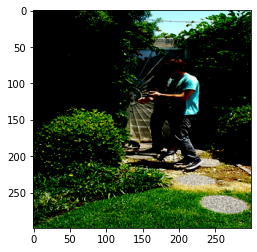

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


two friend enjoy time spent together eos


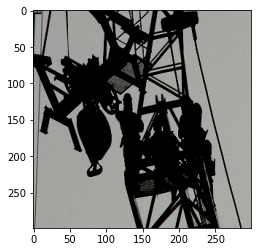

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


three men on large rig eos


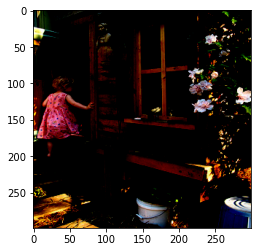

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


girl going into wooden building eos


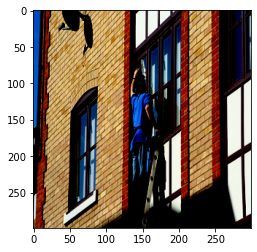

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


man on ladder clean window eos


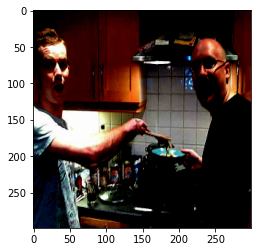

two men are cooking meal eos


In [68]:
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))
for i in range(0,5):
    img = Image.open(IMG + images[i])
    img = img.resize((IMAGE_HEIGHT, IMAGE_WIDTH)) 
    img = img.convert('RGB')
    images_train[0] = preprocess_input(np.array(img, dtype=np.float32))
    fig,ax = plt.subplots(1)
    ax.imshow(images_train[0])
    plt.show()
    img.close()
    print(out[i])

### Tokens

In [69]:
BATCH_SIZE = 64 
EPOCHS = 20 
MAX_NUM_WORDS = 20000

In [70]:
tokenizer_outputs = Tokenizer(num_words=MAX_NUM_WORDS, filters='')
tokenizer_outputs.fit_on_texts(inp + out) 
target_sequences = tokenizer_outputs.texts_to_sequences(out)
target_sequences_inputs = tokenizer_outputs.texts_to_sequences(inp)

In [71]:
word2idx_outputs = tokenizer_outputs.word_index
print(len(word2idx_outputs))

7083


In [72]:
word2idx_outputs

{'sos': 1,
 'eos': 2,
 'in': 3,
 'man': 4,
 'on': 5,
 'is': 6,
 'woman': 7,
 'two': 8,
 'of': 9,
 'people': 10,
 'with': 11,
 'and': 12,
 'are': 13,
 'at': 14,
 'girl': 15,
 'dog': 16,
 'boy': 17,
 'an': 18,
 'playing': 19,
 'young': 20,
 'to': 21,
 'men': 22,
 'child': 23,
 'street': 24,
 'walking': 25,
 'his': 26,
 'sitting': 27,
 'group': 28,
 'down': 29,
 'standing': 30,
 'three': 31,
 'shirt': 32,
 'black': 33,
 'wearing': 34,
 'water': 35,
 'red': 36,
 'play': 37,
 'outside': 38,
 'white': 39,
 'for': 40,
 'holding': 41,
 'blue': 42,
 'her': 43,
 'little': 44,
 'up': 45,
 'looking': 46,
 'person': 47,
 'by': 48,
 'riding': 49,
 'ball': 50,
 'beach': 51,
 'stand': 52,
 'running': 53,
 'bike': 54,
 'front': 55,
 'walk': 56,
 'through': 57,
 'guy': 58,
 'kid': 59,
 'field': 60,
 'into': 61,
 'small': 62,
 'lady': 63,
 'player': 64,
 'crowd': 65,
 'working': 66,
 'jumping': 67,
 'over': 68,
 'hat': 69,
 'snow': 70,
 'out': 71,
 'large': 72,
 'some': 73,
 'city': 74,
 'jump': 75,
 'th

In [73]:
num_words_output = len(word2idx_outputs) + 1
num_words_output

7084

In [74]:
max_len_target = max(len(s) for s in target_sequences)
max_len_target

31

In [75]:
idx2word = {v:k for k, v in word2idx_outputs.items()}
len(idx2word)

7083

In [76]:
idx2word[1]

'sos'

In [77]:
print(word2idx_outputs["sos"])
print(word2idx_outputs["eos"])

1
2


In [78]:
len(target_sequences_inputs)

31783

In [79]:
len(target_sequences)

31783

In [80]:
target_sequences_inputs

[[1, 8, 275, 571, 468, 4177, 117],
 [1, 31, 22, 5, 72, 4178],
 [1, 15, 261, 61, 303, 85],
 [1, 4, 5, 529, 759, 190],
 [1, 8, 22, 13, 245, 440],
 [1, 8, 17, 19, 98],
 [1, 4, 6, 126, 14, 882, 1769],
 [1, 7, 88, 5, 249, 12, 34, 1456],
 [1, 153, 10, 30, 38, 85],
 [1, 8, 58, 67, 68, 805, 117],
 [1, 907, 389, 9, 224, 15, 67, 3, 4179],
 [1, 92, 10, 13, 67, 78, 193, 9, 1191, 9, 306],
 [1, 33, 16, 12, 1770, 16, 13, 469],
 [1, 4, 456, 1919, 2424, 736, 5, 1771, 130, 3, 719],
 [1, 7, 13, 30, 38],
 [1, 30, 7, 122, 1192, 68, 499],
 [1, 20, 15, 11, 2425, 215, 38, 3, 107],
 [1, 4, 596, 5, 108, 26, 16, 97, 48, 433],
 [1, 224, 10, 13, 27, 3, 828, 11, 230],
 [1, 28, 9, 92, 7, 13, 132, 240, 5, 76, 230],
 [1, 4, 3, 131, 12, 367, 30, 5, 291],
 [1, 65, 30, 38, 3288, 196],
 [1, 4, 165, 693, 5, 26, 225],
 [1, 8, 59, 134, 5, 1772],
 [1, 4, 34, 2426, 345, 12, 287, 69, 122, 267, 3, 130],
 [1, 4, 483, 18, 139, 69, 12, 167],
 [1, 4180, 937, 215, 14, 18, 238, 241, 583],
 [1, 4, 3, 470, 330, 6, 368, 205],
 [1, 23, 19

In [81]:
target_sequences

[[8, 275, 571, 468, 4177, 117, 2],
 [31, 22, 5, 72, 4178, 2],
 [15, 261, 61, 303, 85, 2],
 [4, 5, 529, 759, 190, 2],
 [8, 22, 13, 245, 440, 2],
 [8, 17, 19, 98, 2],
 [4, 6, 126, 14, 882, 1769, 2],
 [7, 88, 5, 249, 12, 34, 1456, 2],
 [153, 10, 30, 38, 85, 2],
 [8, 58, 67, 68, 805, 117, 2],
 [907, 389, 9, 224, 15, 67, 3, 4179, 2],
 [92, 10, 13, 67, 78, 193, 9, 1191, 9, 306, 2],
 [33, 16, 12, 1770, 16, 13, 469, 2],
 [4, 456, 1919, 2424, 736, 5, 1771, 130, 3, 719, 2],
 [7, 13, 30, 38, 2],
 [30, 7, 122, 1192, 68, 499, 2],
 [20, 15, 11, 2425, 215, 38, 3, 107, 2],
 [4, 596, 5, 108, 26, 16, 97, 48, 433, 2],
 [224, 10, 13, 27, 3, 828, 11, 230, 2],
 [28, 9, 92, 7, 13, 132, 240, 5, 76, 230, 2],
 [4, 3, 131, 12, 367, 30, 5, 291, 2],
 [65, 30, 38, 3288, 196, 2],
 [4, 165, 693, 5, 26, 225, 2],
 [8, 59, 134, 5, 1772, 2],
 [4, 34, 2426, 345, 12, 287, 69, 122, 267, 3, 130, 2],
 [4, 483, 18, 139, 69, 12, 167, 2],
 [4180, 937, 215, 14, 18, 238, 241, 583, 2],
 [4, 3, 470, 330, 6, 368, 205, 2],
 [23, 19, 5

In [82]:
print(len(idx2word))
print(len(word2idx_outputs))

7083
7083


## padding

In [83]:
decoder_inputs = pad_sequences(target_sequences_inputs, maxlen=max_len_target, padding='post')
print("decoder_inputs[0]:", decoder_inputs[0])
print("decoder_inputs.shape:", decoder_inputs.shape)

decoder_targets = pad_sequences(target_sequences, maxlen=max_len_target, padding='post')

decoder_inputs[0]: [   1    8  275  571  468 4177  117    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0]
decoder_inputs.shape: (31783, 31)


In [84]:
target_sequences_inputs = 0
target_sequences = 0

In [85]:
print(len(decoder_inputs))
print(len(decoder_targets))

31783
31783


In [86]:
print(decoder_inputs[0])
print('\n')
print(decoder_inputs[2])
print('\n')
print(decoder_inputs[4])
print('\n')
print(decoder_inputs[6])

[   1    8  275  571  468 4177  117    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0]


[  1  15 261  61 303  85   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0]


[  1   8  22  13 245 440   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0]


[   1    4    6  126   14  882 1769    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0]


In [87]:
print(decoder_targets[0])
print('\n')
print(decoder_targets[2])
print('\n')
print(decoder_targets[4])
print('\n')
print(decoder_targets[6])

[   8  275  571  468 4177  117    2    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0]


[ 15 261  61 303  85   2   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0]


[  8  22  13 245 440   2   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0]


[   4    6  126   14  882 1769    2    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0]


In [88]:
print(max_len_target)
print(num_words_output)

31
7084


In [89]:
#print(type(decoder_targets_one_hot))
print(type(decoder_inputs))
print(type(images))
print(type(decoder_targets))

<class 'numpy.ndarray'>
<class 'list'>
<class 'numpy.ndarray'>


In [90]:
#print(decoder_targets_one_hot.shape)
print(decoder_inputs.shape)
#print(images.shape)
print(decoder_targets.shape)


(31783, 31)
(31783, 31)


## Model Building

In [91]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, LSTM, GRU, Dense, Embedding, Lambda
from tensorflow.keras.layers import Dropout
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
#import keras.backend as K
import keras
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.layers import Flatten
from tensorflow.keras import optimizers
from tensorflow.keras.layers import Input
from tensorflow.keras.applications.inception_v3 import InceptionV3

In [92]:
def model_feature():
    model = InceptionV3(weights='imagenet')
    model_out = model.layers[-2].output
    model = Model(model.input, model_out)
    return model

In [93]:
model = model_feature()
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 149, 149, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 149, 149, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 149, 149, 32) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [94]:
len(images)

31783

In [41]:
img1

[array([[0.24523592, 0.27874395, 0.77622604, ..., 0.5547674 , 0.2068916 ,
         0.06406777]], dtype=float32),
 array([[0.55131865, 0.14977771, 0.04039197, ..., 1.0518962 , 0.15802824,
         0.8264313 ]], dtype=float32),
 array([[0.09671326, 0.22956355, 0.76096827, ..., 0.415749  , 0.45861784,
         0.4067905 ]], dtype=float32),
 array([[0.6738771 , 0.4848125 , 0.47768074, ..., 0.11247939, 0.58375764,
         1.8400393 ]], dtype=float32),
 array([[0.24549186, 0.39700297, 0.2554221 , ..., 0.47226816, 0.26768625,
         0.8777896 ]], dtype=float32),
 array([[0.7734291 , 0.6751169 , 0.27858317, ..., 0.42140418, 0.37927306,
         0.14206594]], dtype=float32),
 array([[0.21866548, 0.10588741, 0.20285563, ..., 0.6199521 , 0.02653829,
         0.24021393]], dtype=float32),
 array([[0.3656417 , 0.26374018, 0.31232733, ..., 0.66071796, 0.02749897,
         0.7243806 ]], dtype=float32),
 array([[0.48401654, 0.42881995, 0.6987088 , ..., 0.31499094, 0.632574  ,
         0.53690976]],

In [42]:
len(img1)

31783

In [43]:
print(img1[0])
print(img1[8091])
print(img1[16182])
print("\n")
print(img1[2])
print(img1[8093])
print(img1[16184])
print("\n")
print(img1[4])
print(img1[8095])
print(img1[16186])
print("\n")
print(img1[6])
print(img1[8097])
print(img1[16188])

[[0.24523592 0.27874395 0.77622604 ... 0.5547674  0.2068916  0.06406777]]
[[0.5203366  0.513403   0.11631    ... 0.9144085  0.33359808 0.44920903]]
[[0.16374561 0.45005402 0.13659725 ... 0.54987943 0.22924875 0.7563682 ]]


[[0.09671326 0.22956355 0.76096827 ... 0.415749   0.45861784 0.4067905 ]]
[[0.4080987  0.10419618 0.89996433 ... 0.20117605 0.38134292 0.30652982]]
[[0.11554053 0.2819701  0.12416806 ... 0.8523923  0.3797534  0.52250814]]


[[0.24549186 0.39700297 0.2554221  ... 0.47226816 0.26768625 0.8777896 ]]
[[0.09165829 0.01973203 0.16519481 ... 0.08064897 0.5674934  0.24856602]]
[[0.12694038 0.23806095 1.2766573  ... 1.0369085  0.74361694 0.48932183]]


[[0.21866548 0.10588741 0.20285563 ... 0.6199521  0.02653829 0.24021393]]
[[0.25481674 0.4399998  0.18213966 ... 0.05440085 0.7536139  0.01235778]]
[[0.31110588 0.6994368  0.732012   ... 0.27471513 0.1855886  0.6540172 ]]


In [95]:
with open('img_fea_res_1.txt', 'rb') as handle5:
    img2 = pickle.load(handle5)

In [96]:
print(img2[0])
print(img2[8091])
print(img2[16182])
print("\n")
print(img2[2])
print(img2[8093])
print(img2[16184])
print("\n")
print(img2[4])
print(img2[8095])
print(img2[16186])
print("\n")
print(img2[6])
print(img2[8097])
print(img2[16188])

[[0.24523592 0.27874395 0.77622604 ... 0.5547674  0.2068916  0.06406777]]
[[0.5203366  0.513403   0.11631    ... 0.9144085  0.33359808 0.44920903]]
[[0.16374561 0.45005402 0.13659725 ... 0.54987943 0.22924875 0.7563682 ]]


[[0.09671326 0.22956355 0.76096827 ... 0.415749   0.45861784 0.4067905 ]]
[[0.4080987  0.10419618 0.89996433 ... 0.20117605 0.38134292 0.30652982]]
[[0.11554053 0.2819701  0.12416806 ... 0.8523923  0.3797534  0.52250814]]


[[0.24549186 0.39700297 0.2554221  ... 0.47226816 0.26768625 0.8777896 ]]
[[0.09165829 0.01973203 0.16519481 ... 0.08064897 0.5674934  0.24856602]]
[[0.12694038 0.23806095 1.2766573  ... 1.0369085  0.74361694 0.48932183]]


[[0.21866548 0.10588741 0.20285563 ... 0.6199521  0.02653829 0.24021393]]
[[0.25481674 0.4399998  0.18213966 ... 0.05440085 0.7536139  0.01235778]]
[[0.31110588 0.6994368  0.732012   ... 0.27471513 0.1855886  0.6540172 ]]


In [97]:
img1 = 0
img2 = np.asarray(img2)

In [98]:
img2.shape

(31783, 1, 2048)

In [99]:
img2[1]

array([[0.55131865, 0.14977771, 0.04039197, ..., 1.0518962 , 0.15802824,
        0.8264313 ]], dtype=float32)

In [100]:
img2.shape

(31783, 1, 2048)

In [101]:
img2 = img2.reshape(31783,2048)
img2.shape

(31783, 2048)

In [102]:
img2

array([[0.24523592, 0.27874395, 0.77622604, ..., 0.5547674 , 0.2068916 ,
        0.06406777],
       [0.55131865, 0.14977771, 0.04039197, ..., 1.0518962 , 0.15802824,
        0.8264313 ],
       [0.09671326, 0.22956355, 0.76096827, ..., 0.415749  , 0.45861784,
        0.4067905 ],
       ...,
       [0.39776248, 0.60150105, 0.30375308, ..., 0.0671968 , 0.6589602 ,
        1.1234865 ],
       [0.15688801, 0.21790974, 0.2793831 , ..., 0.3342055 , 0.19411765,
        0.0966762 ],
       [0.0709046 , 0.33124006, 0.2669351 , ..., 0.14507036, 0.28538954,
        0.03737149]], dtype=float32)

In [103]:
decoder_targets

array([[   8,  275,  571, ...,    0,    0,    0],
       [  31,   22,    5, ...,    0,    0,    0],
       [  15,  261,   61, ...,    0,    0,    0],
       ...,
       [ 337, 7082,   48, ...,    0,    0,    0],
       [  18,  232,  388, ...,    0,    0,    0],
       [   4,    5, 4119, ...,    0,    0,    0]])

In [104]:
decoder_inputs

array([[   1,    8,  275, ...,    0,    0,    0],
       [   1,   31,   22, ...,    0,    0,    0],
       [   1,   15,  261, ...,    0,    0,    0],
       ...,
       [   1,  337, 7082, ...,    0,    0,    0],
       [   1,   18,  232, ...,    0,    0,    0],
       [   1,    4,    5, ...,    0,    0,    0]])

## 3 HEREEE

In [105]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import optimizers
from tensorflow.keras.layers import BatchNormalization, Dropout, Flatten

In [106]:
lat_dim = 712
feature_size = 2048
embedding_size = 300
#lat_dim1 = 2048
#lat_dim2 = 1024

In [107]:
transfer_input = Input(shape=(feature_size,), name='aaa')
transfer= Dense(lat_dim, activation='tanh', name='bbb')
encoder_states = transfer(transfer_input)


decoder_inputs_placeholder = Input(shape=(max_len_target,), name='ccc')
decoder_embedding = Embedding(num_words_output, embedding_size, name='dddd')
decoder_inputs_x = decoder_embedding(decoder_inputs_placeholder)

decoder_inputs_x = Dropout(0.4)(decoder_inputs_x)
decoder_lstm = GRU(lat_dim, return_state = True, return_sequences = True, dropout = 0.5, name='eeee')
decoder_outputs,_ = decoder_lstm(decoder_inputs_x, initial_state = encoder_states)
#ecoder_outputs = Dropout(0.4)(decoder_outputs)

decoder_dense = Dense(num_words_output, activation='softmax', name='ffff')
decoder_outputs = decoder_dense(decoder_outputs)

model_gru = Model([transfer_input, decoder_inputs_placeholder], decoder_outputs)

In [108]:
from tensorflow.keras.optimizers import RMSprop
    
   #model.compile(optimizer = adam, loss = 'categorical_crossentropy', metrics = ['accuracy'])
model_gru.compile(optimizer=RMSprop(lr=1e-3, decay=0.000001),
                      loss='sparse_categorical_crossentropy', metrics = ['accuracy'])

In [109]:
model_gru.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
ccc (InputLayer)                [(None, 31)]         0                                            
__________________________________________________________________________________________________
dddd (Embedding)                (None, 31, 300)      2125200     ccc[0][0]                        
__________________________________________________________________________________________________
aaa (InputLayer)                [(None, 2048)]       0                                            
__________________________________________________________________________________________________
dropout (Dropout)               (None, 31, 300)      0           dddd[0][0]                       
____________________________________________________________________________________________

In [110]:
r = model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=20,
  validation_split=0.1
  #callbacks=[reduce_lr]
)

Train on 28604 samples, validate on 3179 samples
Epoch 1/20
23744/28604 [=======================>......] - ETA: 7s - loss: 1.2043 - accuracy: 0.8114 - ET

KeyboardInterrupt: 

##  For output

In [ ]:
encoder_model = Model([transfer_input], encoder_states)
encoder_model.summary()

In [ ]:
decoder_state_input_h = Input(shape=(lat_dim,))

decoder_states_inputs = [decoder_state_input_h]


decoder_inputs_single = Input(shape=(1,))
decoder_inputs_single_x = decoder_embedding(decoder_inputs_single)
decoder_outputs,h = decoder_lstm(decoder_inputs_single_x, initial_state = decoder_states_inputs)
    
decoder_states  = [h]
decoder_outputs = decoder_dense(decoder_outputs)


decoder_model = Model([decoder_inputs_single] + decoder_states_inputs, [decoder_outputs] + decoder_states)

In [ ]:
decoder_model.summary()

In [ ]:
def k2(input_img): 
    input_img = input_img.reshape(1,IMAGE_HEIGHT, IMAGE_WIDTH, 3)
    fea_vec = model.predict(input_img) 
    fea_vec = fea_vec.reshape(1,2048)  
    states_value = encoder_model.predict(fea_vec) 
    states_value = [states_value,states_value]
    target_seq = np.zeros((1,1))
    target_seq[0,0] = word2idx_outputs["sos"]
    eos = word2idx_outputs["eos"]
    
    output_sentence = []
    for i in range(max_len_target):      
        output_tokens,h = decoder_model.predict([target_seq] + states_value)   
        idx = np.argmax(output_tokens[0, 0, :])
        
        if eos == idx:
            break

        word = ''
        
        if idx > 0:
            word = idx2word[idx]
            output_sentence.append(word)

        target_seq[0,0] = idx 
        states_value = [h]
    
    return ' '.join(output_sentence)    
    



In [ ]:
def predictions(ip):
    images_train=0
    images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))
    img3 = Image.open(IMG + images[ip])

    fig,ax = plt.subplots(1)
    ax.imshow(img3, cmap=plt.cm.gray)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH)) 
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

In [ ]:
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'

for i in range(0,10):
    predictions(i)

## Test

In [ ]:
import os
img_test = []
for i in os.listdir('C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test'):
    img_test.append(i)

In [ ]:
img_test

In [ ]:
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

### 2nd iteration

In [ ]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=5,
  validation_split=0.1
)

In [ ]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

In [ ]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

### 3nd iteration

In [ ]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=5,
  validation_split=0.1
)

In [ ]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

In [ ]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

### 4th 

In [ ]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=5,
  validation_split=0.1
)

In [ ]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

In [ ]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

### 5th 

In [ ]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=10,
  validation_split=0.1
)

In [ ]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

In [ ]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

## 6th 

In [ ]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=10,
  validation_split=0.1
)

In [ ]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

In [ ]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

## 3 HEREEE

In [111]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import optimizers
from tensorflow.keras.layers import BatchNormalization, Dropout, Flatten

In [112]:
lat_dim = 712
feature_size = 2048
embedding_size = 300
#lat_dim1 = 2048
#lat_dim2 = 1024

In [113]:
transfer_input = Input(shape=(feature_size,), name='aaa')
transfer= Dense(lat_dim, activation='tanh', name='bbb')
encoder_states = transfer(transfer_input)


decoder_inputs_placeholder = Input(shape=(max_len_target,), name='ccc')
decoder_embedding = Embedding(num_words_output, embedding_size, name='dddd')
decoder_inputs_x = decoder_embedding(decoder_inputs_placeholder)

decoder_inputs_x = Dropout(0.3)(decoder_inputs_x)
decoder_lstm = GRU(lat_dim, return_state = True, return_sequences = True, dropout = 0.5, name='eeee')
decoder_outputs,_ = decoder_lstm(decoder_inputs_x, initial_state = encoder_states)
#ecoder_outputs = Dropout(0.4)(decoder_outputs)

decoder_dense = Dense(num_words_output, activation='softmax', name='ffff')
decoder_outputs = decoder_dense(decoder_outputs)

model_gru = Model([transfer_input, decoder_inputs_placeholder], decoder_outputs)

In [114]:
from tensorflow.keras.optimizers import RMSprop
    
   #model.compile(optimizer = adam, loss = 'categorical_crossentropy', metrics = ['accuracy'])
model_gru.compile(optimizer=RMSprop(lr=1e-3),
                      loss='sparse_categorical_crossentropy', metrics = ['accuracy'])

In [115]:
model_gru.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
ccc (InputLayer)                [(None, 31)]         0                                            
__________________________________________________________________________________________________
dddd (Embedding)                (None, 31, 300)      2125200     ccc[0][0]                        
__________________________________________________________________________________________________
aaa (InputLayer)                [(None, 2048)]       0                                            
__________________________________________________________________________________________________
dropout_1 (Dropout)             (None, 31, 300)      0           dddd[0][0]                       
____________________________________________________________________________________________

In [116]:
r = model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=20,
  validation_split=0.1
  #callbacks=[reduce_lr]
)

Train on 28604 samples, validate on 3179 samples
Epoch 1/20
28604/28604 [==============================] - 43s 1ms/sample - loss: 1.1735 - accuracy: 0.8143 - val_loss: 1.1288 - val_accuracy: 0.8148
Epoch 2/20
28604/28604 [==============================] - 41s 1ms/sample - loss: 0.9433 - accuracy: 0.8333 - val_loss: 1.0670 - val_accuracy: 0.8205
Epoch 3/20
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.8795 - accuracy: 0.8391 - val_loss: 1.0378 - val_accuracy: 0.8240
Epoch 4/20
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.8324 - accuracy: 0.8437 - val_loss: 1.0211 - val_accuracy: 0.8256
Epoch 5/20
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.7896 - accuracy: 0.8484 - val_loss: 1.0210 - val_accuracy: 0.8255
Epoch 6/20
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.7484 - accuracy: 0.8529 - val_loss: 1.0192 - val_accuracy: 0.8247
Epoch 7/20
28604/28604 [==============================] -

##  For output

In [117]:
encoder_model = Model([transfer_input], encoder_states)
encoder_model.summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
aaa (InputLayer)             [(None, 2048)]            0         
_________________________________________________________________
bbb (Dense)                  (None, 712)               1458888   
Total params: 1,458,888
Trainable params: 1,458,888
Non-trainable params: 0
_________________________________________________________________


In [118]:
decoder_state_input_h = Input(shape=(lat_dim,))

decoder_states_inputs = [decoder_state_input_h]


decoder_inputs_single = Input(shape=(1,))
decoder_inputs_single_x = decoder_embedding(decoder_inputs_single)
decoder_outputs,h = decoder_lstm(decoder_inputs_single_x, initial_state = decoder_states_inputs)
    
decoder_states  = [h]
decoder_outputs = decoder_dense(decoder_outputs)


decoder_model = Model([decoder_inputs_single] + decoder_states_inputs, [decoder_outputs] + decoder_states)

In [119]:
decoder_model.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 1)]          0                                            
__________________________________________________________________________________________________
dddd (Embedding)                multiple             2125200     input_3[0][0]                    
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 712)]        0                                            
__________________________________________________________________________________________________
eeee (GRU)                      multiple             2165904     dddd[1][0]                       
                                                                 input_2[0][0]              

In [120]:
def k2(input_img): 
    input_img = input_img.reshape(1,IMAGE_HEIGHT, IMAGE_WIDTH, 3)
    fea_vec = model.predict(input_img) 
    fea_vec = fea_vec.reshape(1,2048)  
    states_value = encoder_model.predict(fea_vec) 
    states_value = [states_value,states_value]
    target_seq = np.zeros((1,1))
    target_seq[0,0] = word2idx_outputs["sos"]
    eos = word2idx_outputs["eos"]
    
    output_sentence = []
    for i in range(max_len_target):      
        output_tokens,h = decoder_model.predict([target_seq] + states_value)   
        idx = np.argmax(output_tokens[0, 0, :])
        
        if eos == idx:
            break

        word = ''
        
        if idx > 0:
            word = idx2word[idx]
            output_sentence.append(word)

        target_seq[0,0] = idx 
        states_value = [h]
    
    return ' '.join(output_sentence)    
    



In [121]:
def predictions(ip):
    images_train=0
    images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))
    img3 = Image.open(IMG + images[ip])

    fig,ax = plt.subplots(1)
    ax.imshow(img3, cmap=plt.cm.gray)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH)) 
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

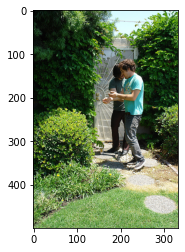

man in white shirt is standing in front of tree


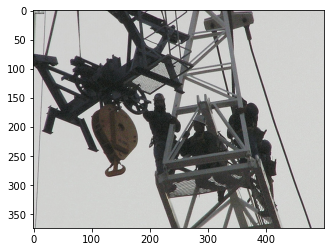

three men on large park


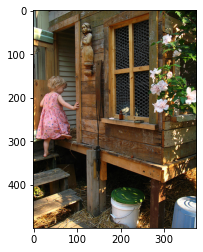

man in blue shirt is getting some food in building


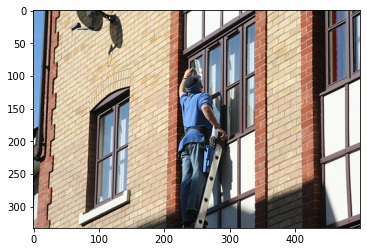

man on ladder clean window


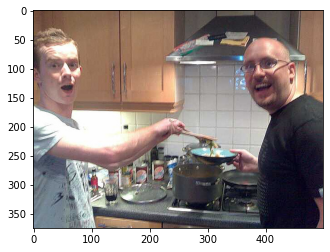

two men are cooking meal


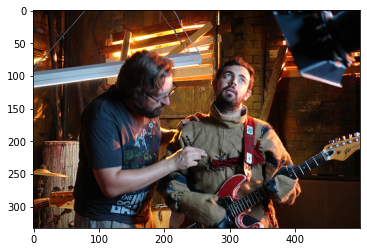

two young people wearing hat are playing guitar


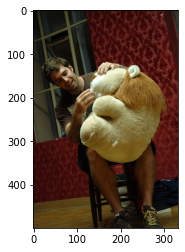

man is holding his arm


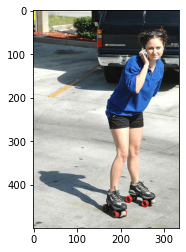

woman wearing purple is running


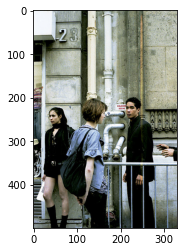

two woman one standing on street


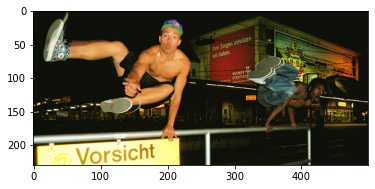

two woman are dancing together


In [122]:
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'

for i in range(0,10):
    predictions(i)

## Test

In [123]:
import os
img_test = []
for i in os.listdir('C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test'):
    img_test.append(i)

In [124]:
img_test

['boat.jpg',
 'Climbing-Mountain.jpg',
 'dog.jpg',
 'dog2.jpg',
 'getty_182057942_200013312000928075_94404.jpg',
 'human1.jpg',
 'man blacksuit.jpg',
 'mansnow.jpg',
 'music_1582500c.jpg',
 'one2.jpg',
 'two.jpg',
 'twoww.jpg',
 'ww.jpg',
 'x.jpg']

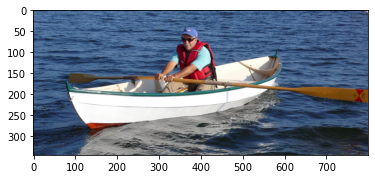

man is riding in boat on water


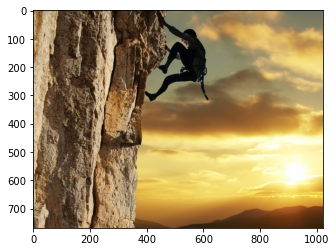

man sits on rock ride


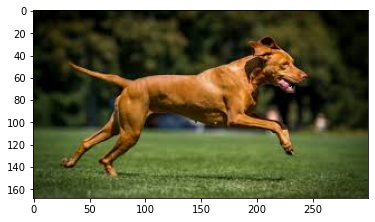

two dog run on grass


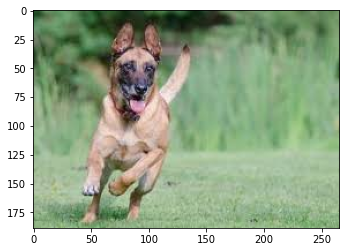

brown dog holding red ball in his mouth


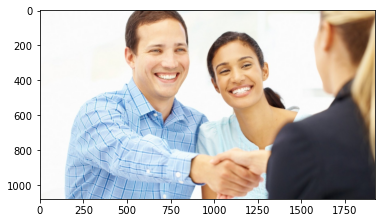

one man holding another child look on


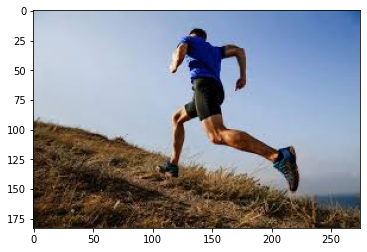

man jumping into air


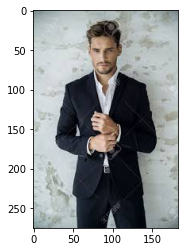

man in black jacket is holding his hand


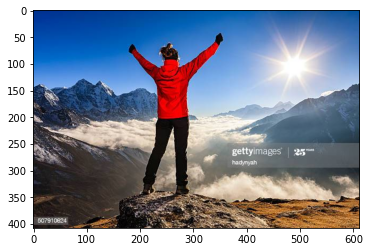

man stand on mountain looking at painting


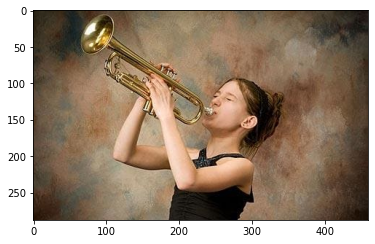

man in black is playing trumpet


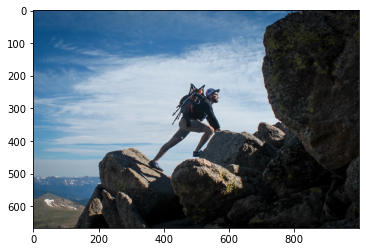

man with his arm on rocky cliff


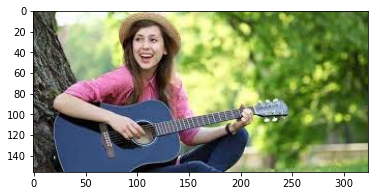

young man with long hair is sitting down near playing guitar


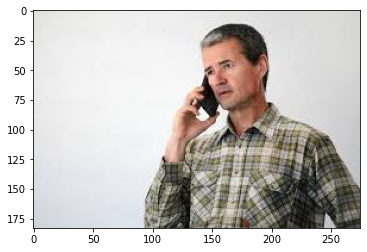

woman with brown hair is using her cellphone


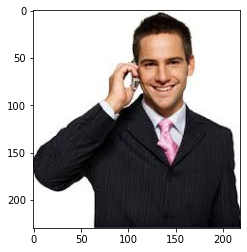

an male man in suit and giving tie


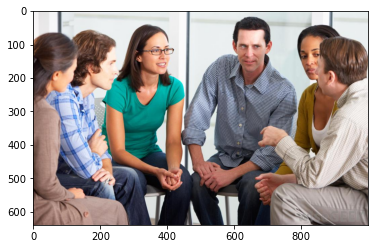

group of people sitting together on sunny day


In [125]:
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

### 2nd iteration

In [126]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=5,
  validation_split=0.1
)

Train on 28604 samples, validate on 3179 samples
Epoch 1/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.3040 - accuracy: 0.9440 - val_loss: 1.2451 - val_accuracy: 0.8177
Epoch 2/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.2859 - accuracy: 0.9479 - val_loss: 1.2629 - val_accuracy: 0.8160
Epoch 3/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.2686 - accuracy: 0.9518 - val_loss: 1.2785 - val_accuracy: 0.8172
Epoch 4/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.2536 - accuracy: 0.9545 - val_loss: 1.2915 - val_accuracy: 0.8159
Epoch 5/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.2390 - accuracy: 0.9574 - val_loss: 1.3047 - val_accuracy: 0.8162


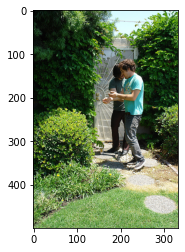

man in white shirt is walking in front of tree


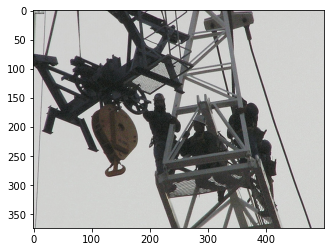

three men on large park


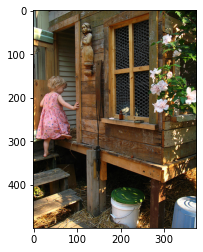

man in blue shirt and blue jacket is using blue player


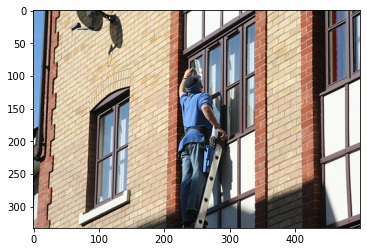

man on ladder clean window


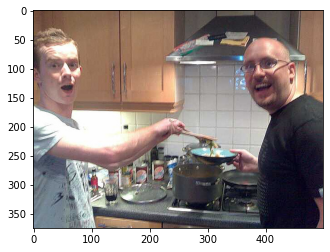

two men cooking food in kitchen


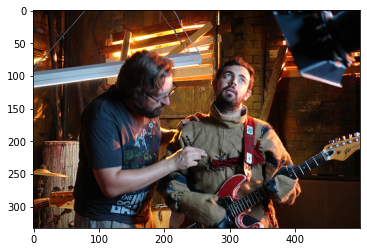

two young people wearing hat and playing guitar


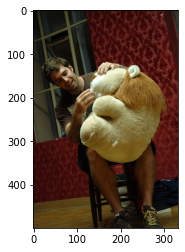

man is holding large child


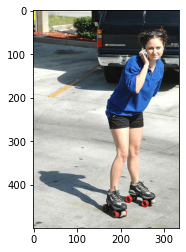

woman wearing black tank top is walking


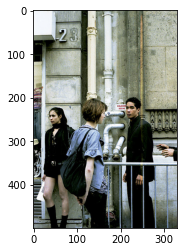

two woman dressed a older man is walking down sidewalk


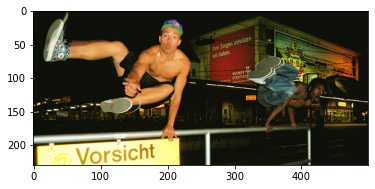

two guy jumping over gate together


In [127]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

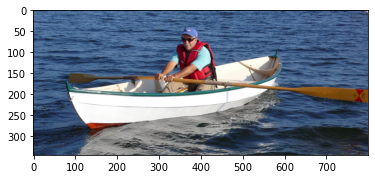

man is riding in boat with water in his food


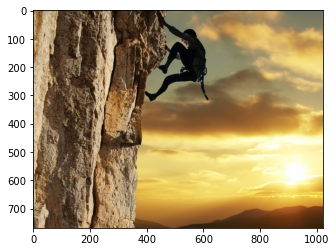

person is rock climbing


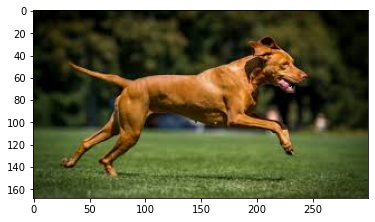

brown dog running on grass


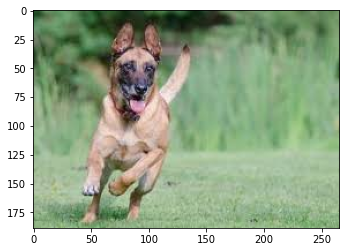

brown dog holding red stick in mouth


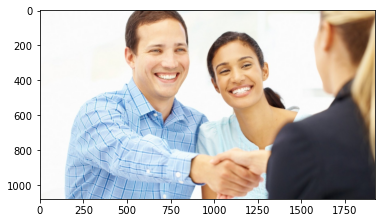

young man being smiling by


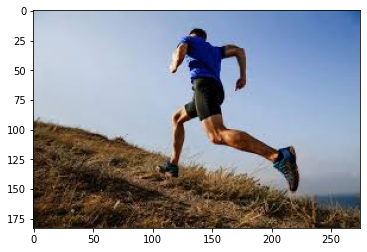

man jumping into air


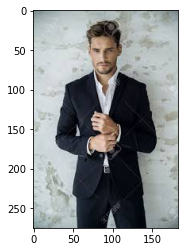

an old man play an instrument


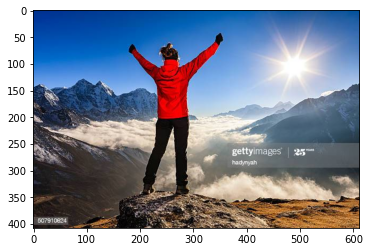

man stand in front of snow covered mountain


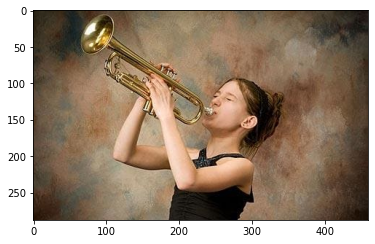

man in black shirt play trumpet


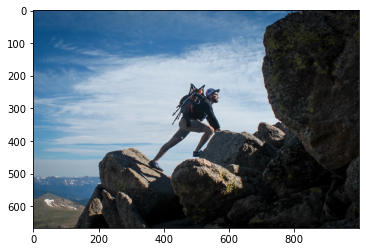

man in red shirt is walking on rock


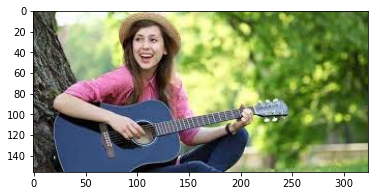

man in hat cap playing guitar


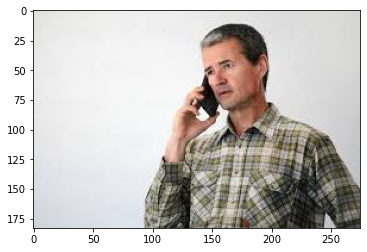

person with an for hair is walking


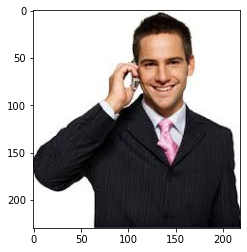

an elderly man with glass is walking with his dog on lawn


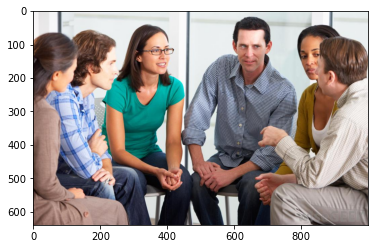

group of people sitting together on chair


In [128]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

### 3nd iteration

In [129]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=5,
  validation_split=0.1
)

Train on 28604 samples, validate on 3179 samples
Epoch 1/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.2256 - accuracy: 0.9600 - val_loss: 1.3141 - val_accuracy: 0.8156
Epoch 2/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.2135 - accuracy: 0.9619 - val_loss: 1.3211 - val_accuracy: 0.8152
Epoch 3/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.2024 - accuracy: 0.9642 - val_loss: 1.3319 - val_accuracy: 0.8150
Epoch 4/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1925 - accuracy: 0.9658 - val_loss: 1.3426 - val_accuracy: 0.8158
Epoch 5/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1833 - accuracy: 0.9672 - val_loss: 1.3497 - val_accuracy: 0.8152


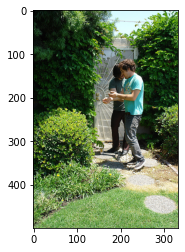

two friend enjoy time their together


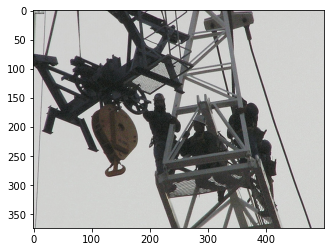

three men on large bike


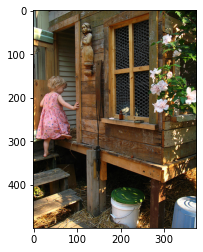

boy going into wooden building


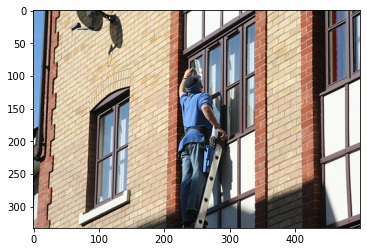

man on ladder clean window


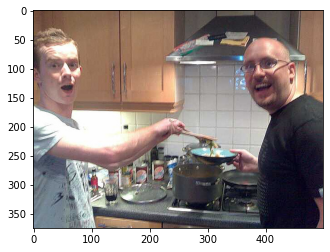

two men are cooking meal


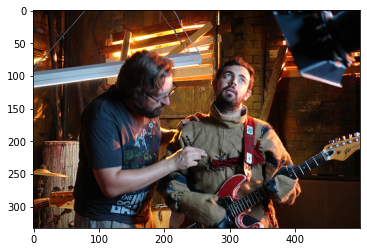

two boy playing guitar


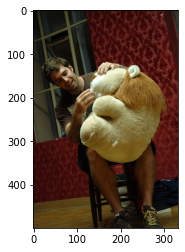

man is smiling at stuffed animal


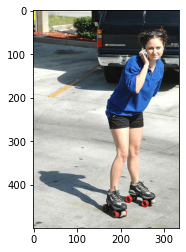

woman with blue shirt is running


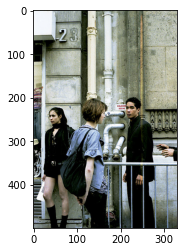

group of people standing outside building


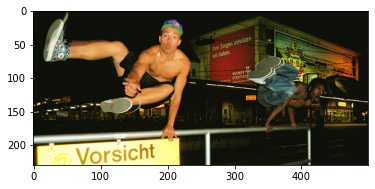

two guy jumping over gate together


In [130]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

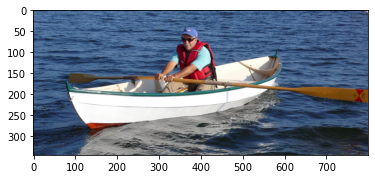

man in black child on lake in front of water


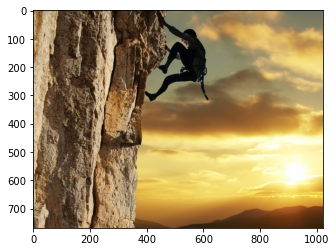

man sits on rock


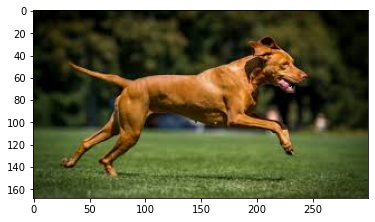

two dog running over grassy field


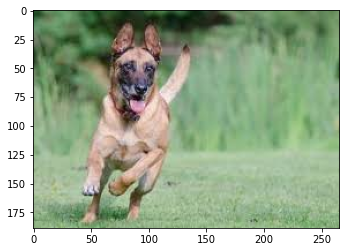

brown dog holding man in his mouth


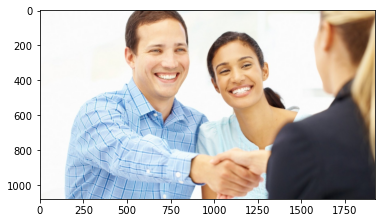

man smiling woman on


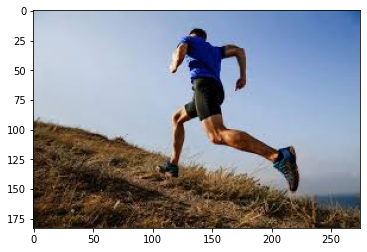

man jumping into air


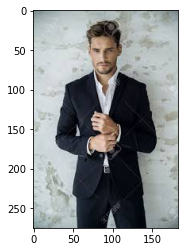

man in black shirt is holding cigarette


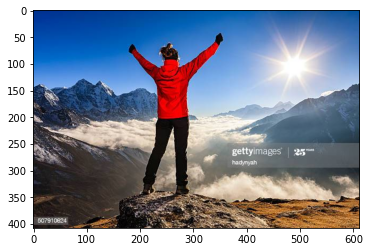

man in red coat stand in front of snow


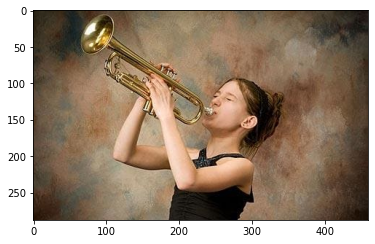

man in black shirt playing an instrument


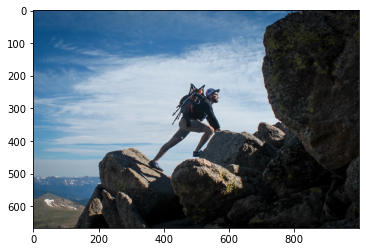

man in red sitting on bicycle


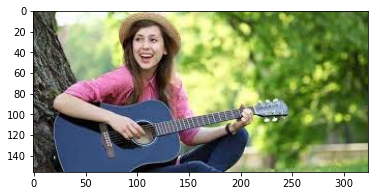

girl in blue cap playing guitar


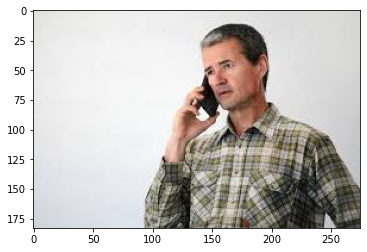

woman with carrying hair is using phone


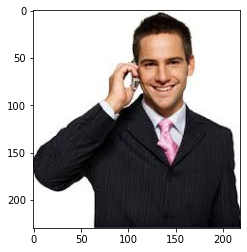

an male man in suit and blue shirt


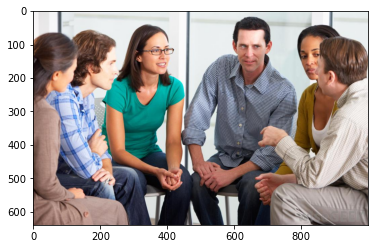

four men and woman on bench


In [131]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

### 4th 

In [132]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=5,
  validation_split=0.1
)

Train on 28604 samples, validate on 3179 samples
Epoch 1/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1747 - accuracy: 0.9688 - val_loss: 1.3565 - val_accuracy: 0.8146
Epoch 2/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1666 - accuracy: 0.9699 - val_loss: 1.3662 - val_accuracy: 0.8148
Epoch 3/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1606 - accuracy: 0.9708 - val_loss: 1.3715 - val_accuracy: 0.8144
Epoch 4/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1552 - accuracy: 0.9716 - val_loss: 1.3686 - val_accuracy: 0.8149
Epoch 5/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1487 - accuracy: 0.9729 - val_loss: 1.3839 - val_accuracy: 0.8143


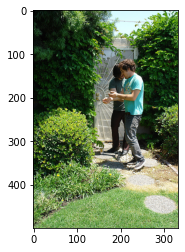

two men walking together in park


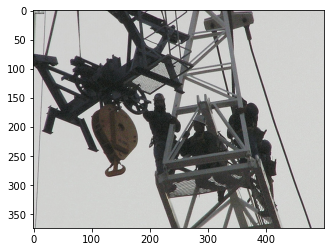

three men on large park


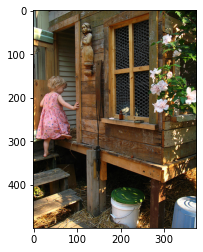

2 child outside wooden ladder


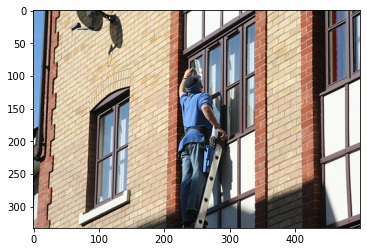

man on ladder clean window


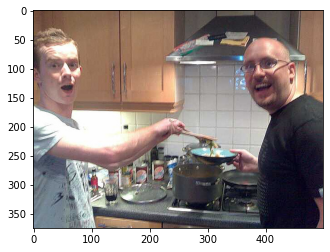

two men are cooking meal


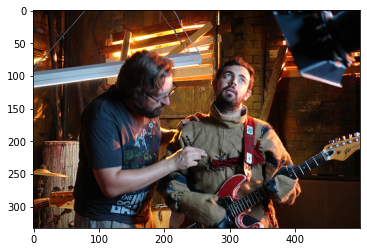

two girl playing guitar


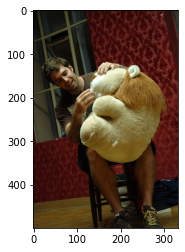

man is smiling at stuffed two dancing


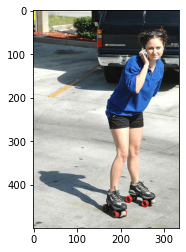

woman talking on cellphone and wearing rollerskates


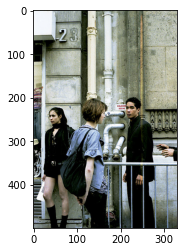

woman outside with her building


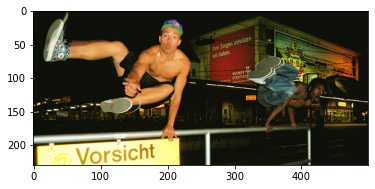

two guy jumping over gate together


In [133]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

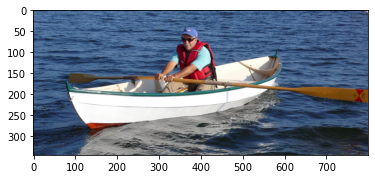

man is using boat on small in small boat with board in background


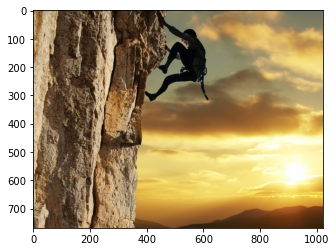

man people jumping off rock and over cliff


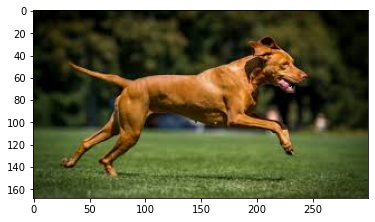

brown dog running in field


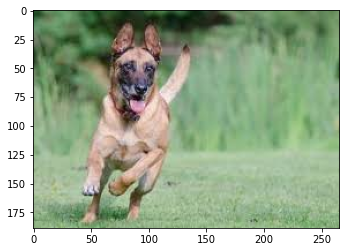

brown dog holding ball in his mouth


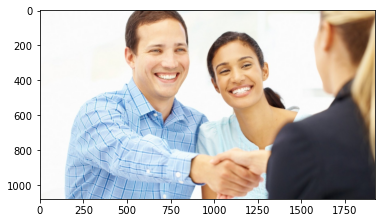

man who is being smiling by other


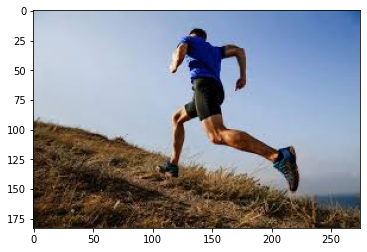

man jumping into air


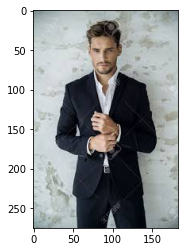

an old man stand on sunny wall


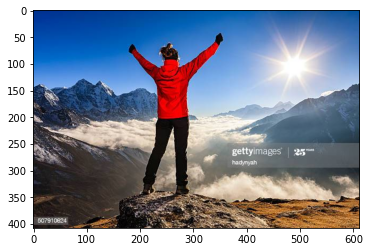

man standing in snow with mountain


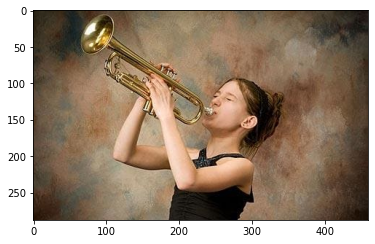

man in striped shirt play trumpet


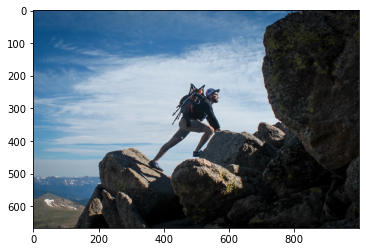

man playing on rock near mountain


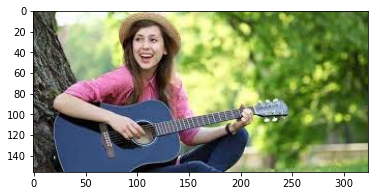

man in hat sitting playing guitar


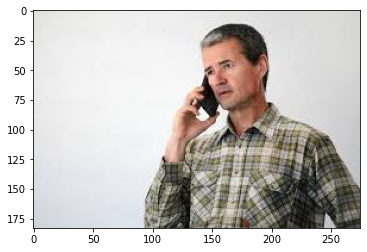

woman with brown hair talking on phone


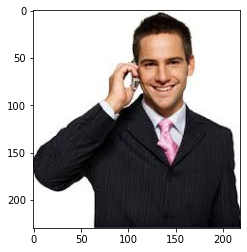

man walking male and holding man


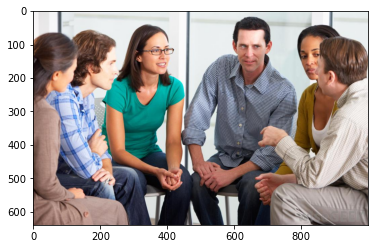

group of people


In [134]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

### 5th 

In [135]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=5,
  validation_split=0.1
)

Train on 28604 samples, validate on 3179 samples
Epoch 1/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1450 - accuracy: 0.9733 - val_loss: 1.3852 - val_accuracy: 0.8137
Epoch 2/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1403 - accuracy: 0.9740 - val_loss: 1.3875 - val_accuracy: 0.8144
Epoch 3/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1370 - accuracy: 0.9744 - val_loss: 1.3922 - val_accuracy: 0.8140
Epoch 4/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1326 - accuracy: 0.9751 - val_loss: 1.4012 - val_accuracy: 0.8139
Epoch 5/5
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1294 - accuracy: 0.9758 - val_loss: 1.3978 - val_accuracy: 0.8146


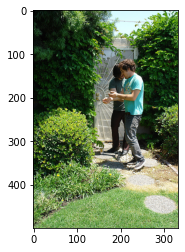

two men enjoy time outside of tree


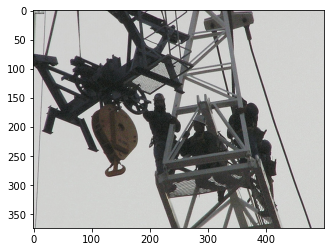

three men on large rig


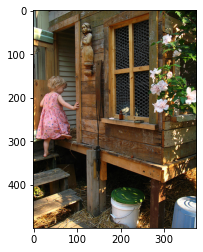

girl going into wooden building


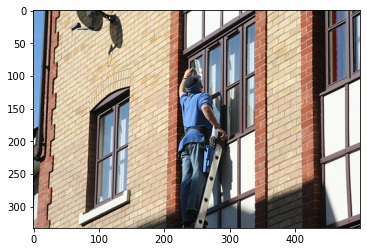

man on ladder clean window


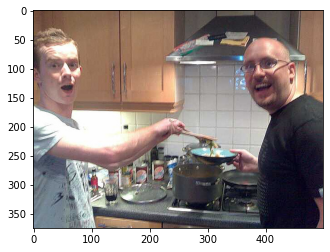

two men are cooking meal


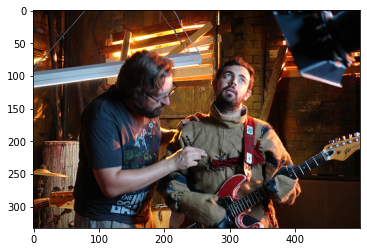

two boy playing guitar


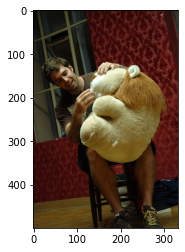

man is smiling at stuffed lion


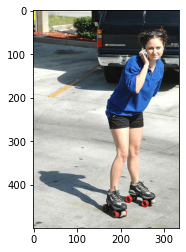

woman talking on cellphone and wearing rollerskates


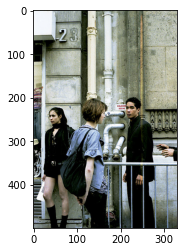

four people standing outside building


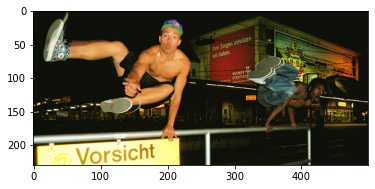

two guy jumping over gate together


In [136]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

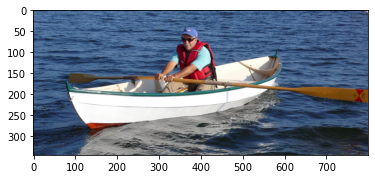

man is riding in boat on water


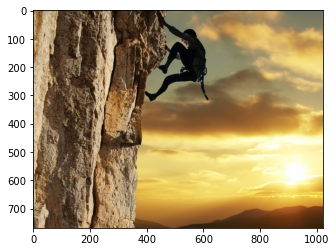

man sits on rock


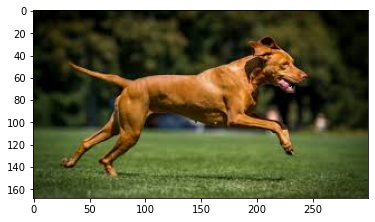

brown dog run on grass


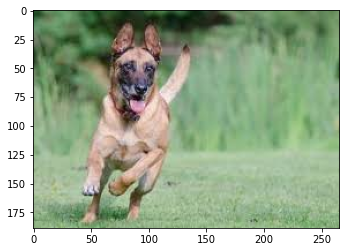

brown dog holding down red dog


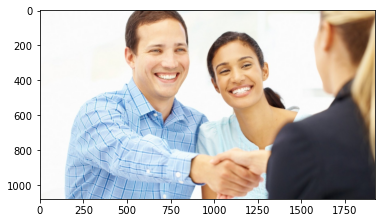

man smiling


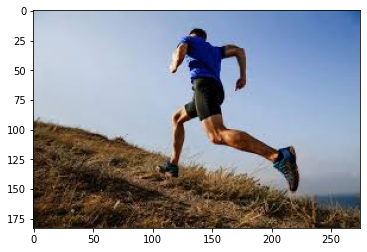

man jumping high down hill


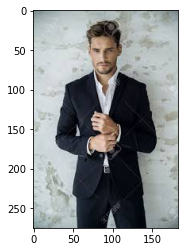

man in black shirt is walking


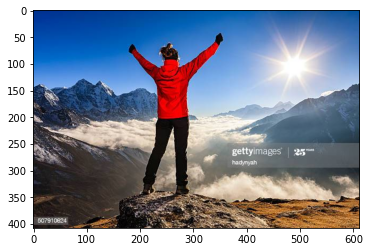

man and woman are standing in snow next to mountain


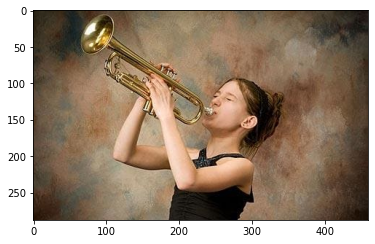

man in striped shirt play trumpet


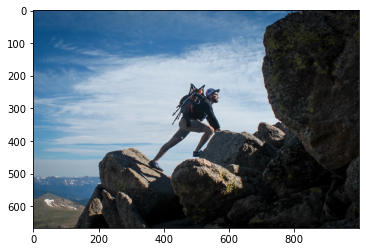

man with two dog on in air


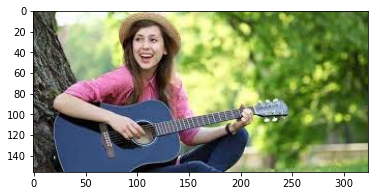

man in sitting playing guitar in what clothing


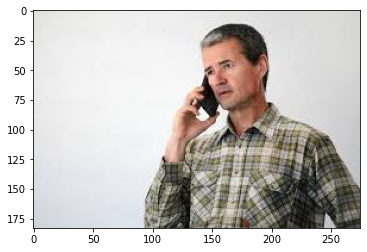

woman with carrying hair


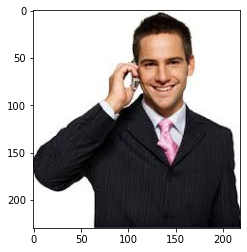

three men in black shirt stand near pose


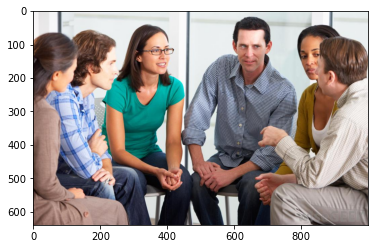

man and his woman pose on couch


In [137]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))

## 6th 

In [138]:
model_gru.fit(
  [img2, decoder_inputs], decoder_targets,
  batch_size=BATCH_SIZE,
  epochs=10,
  validation_split=0.1
)

Train on 28604 samples, validate on 3179 samples
Epoch 1/10
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1264 - accuracy: 0.9761 - val_loss: 1.4010 - val_accuracy: 0.8144
Epoch 2/10
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1253 - accuracy: 0.9762 - val_loss: 1.4063 - val_accuracy: 0.8137
Epoch 3/10
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1231 - accuracy: 0.9767 - val_loss: 1.4106 - val_accuracy: 0.8144
Epoch 4/10
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1211 - accuracy: 0.9770 - val_loss: 1.4147 - val_accuracy: 0.8137
Epoch 5/10
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1188 - accuracy: 0.9774 - val_loss: 1.4132 - val_accuracy: 0.8136
Epoch 6/10
28604/28604 [==============================] - 40s 1ms/sample - loss: 0.1186 - accuracy: 0.9775 - val_loss: 1.4115 - val_accuracy: 0.8135
Epoch 7/10
28604/28604 [==============================] -

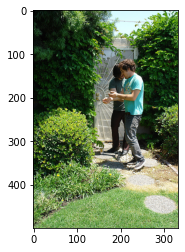

two friend enjoy time time together


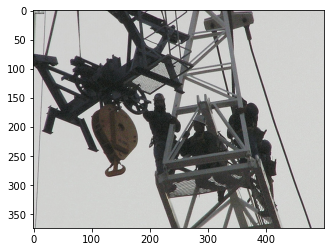

three men on large rig


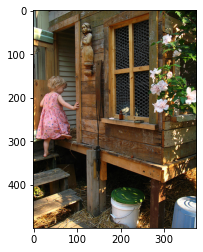

girl going into wooden building


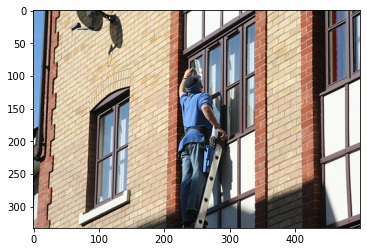

man on ladder clean window


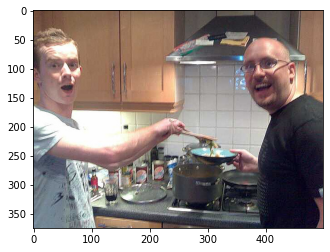

two men are cooking meal


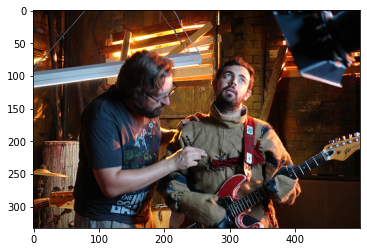

two boy playing guitar


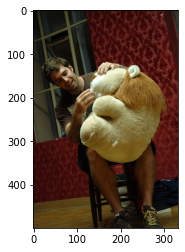

man is smiling at stuffed holding boy


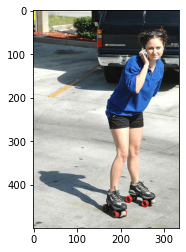

woman talking on cellphone and wearing rollerskates


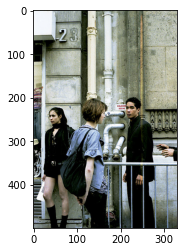

several people standing outside building


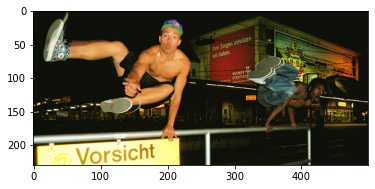

two guy jumping over gate together


In [139]:
IMAGE_HEIGHT = 299
IMAGE_WIDTH = 299
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\fliker 30k\\flickr30k_images\\'


for i in range(0,10):
    predictions(i)

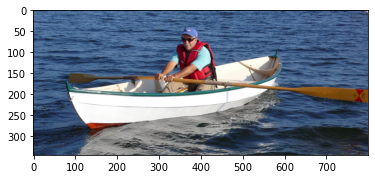

man is kayaking in boat


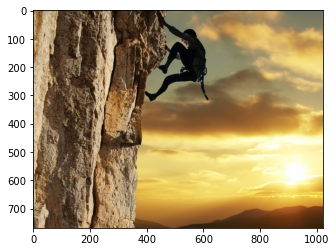

person sits on rock


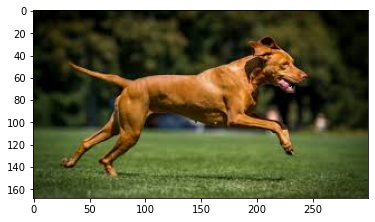

brown dog running


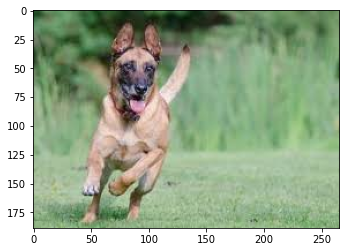

brown dog playing in field


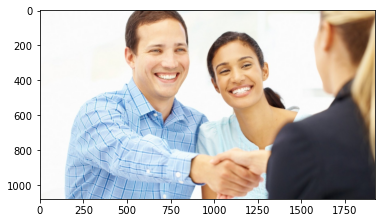

two men smiling


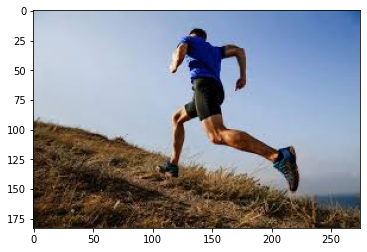

man jumping into air


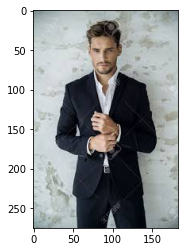

man and black woman giving hand


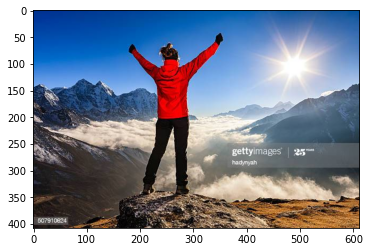

man is standing on top of snow


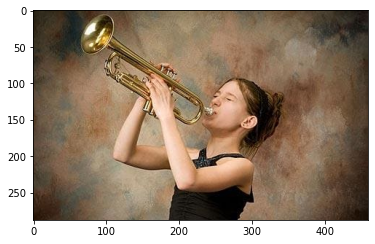

man playing on instrument


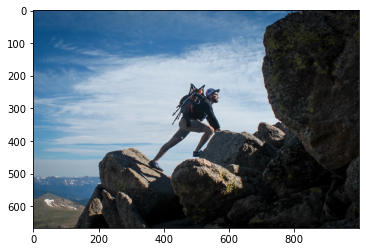

man in red jacket is jumping on rock


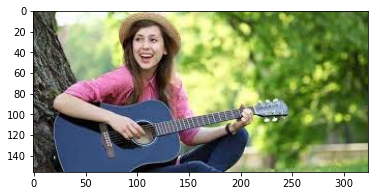

man with hat is playing guitar


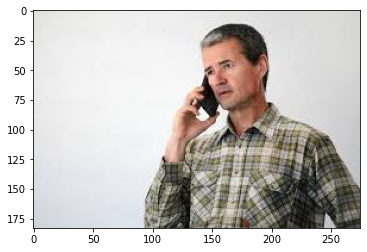

woman with an young boy is talking on his cellphone


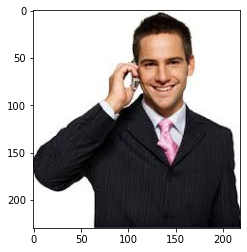

two men dressed in black holding


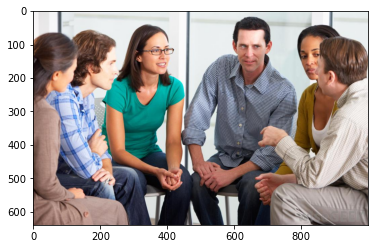

group of people sitting together and on another another are in black black shirt


In [140]:
#######TEST
IMG = 'C:\\Users\\sarth\\Anaconda projects\\self projects and others\\Image captions\\test\\'
images_train=0
images_train = np.zeros((1, IMAGE_HEIGHT, IMAGE_WIDTH, 3))

for i in range(0,14):
    img3 = Image.open(IMG + img_test[i])
    fig,ax = plt.subplots(1)
    ax.imshow(img3)
    plt.show()
    
    img3 = img3.resize((IMAGE_HEIGHT, IMAGE_WIDTH))
    img3 = img3.convert('RGB')
    images_train[0] = preprocess_input(np.array(img3, dtype=np.float32))
    print(k2(images_train[0]))